In [218]:
using Plots
using LinearAlgebra
using Distributions
using LaTeXStrings

In [276]:
# data = [1 0; 0 1; 1 1; 0.5 0.5]

In [277]:
# a1 = 1
# a2 = 1
# b = 1

# CA = [a1 0; 0 a2]
# CB = [b 0; 0 0];

In [278]:
# Ctotinv = inv(cholesky(CA + CB))

In [279]:
# CA * Ctotinv * data'

In [280]:
# CB * Ctotinv * data'

Let's pretend we have two 2D variables with different shaped distributions.

In [224]:
mu = [0,0]
cov1 = [1 0; 0 1]
cov2 = [1 0.5; 0.5 1]
dist1 = MvNormal(mu, cov1)
dist2 = MvNormal(mu, cov2)

FullNormal(
dim: 2
μ: [0.0, 0.0]
Σ: [1.0 0.5; 0.5 1.0]
)


In [225]:
function plot_2d_dist(x; title="")
    plot(x[1,:], x[2,:], seriestype=:scatter, alpha = 0.2, title=title)
end

plot_2d_dist (generic function with 1 method)

Generate 10000 samples from each of them. The distributions look different.

In [270]:
samples1 = rand(dist1, 10000);
samples2 = rand(dist2, 10000);

# p1 = plot(samples1[1,:], samples1[2,:], seriestype=:scatter, alpha = 0.2, title=L"x_1", legend=:none,titlefontsize=24)
# p2 = plot(samples2[1,:], samples2[2,:], seriestype=:scatter, alpha = 0.2, title=L"x_2", legend=:none,titlefontsize=24)
# p = plot(p1,p2, layout=(1,2), size=(1000,500))


In [264]:
savefig(p,"../G2/APMTH210/final_project_figures/gaussiancomponents.pdf")

"/Users/anasofiauzsoy/Desktop/School_Stuff/G2/APMTH210/final_project_figures/gaussiancomponents.pdf"

In [265]:
## plot(samples1[1,:], samples1[2,:], seriestype=:scatter, alpha = 0.2)
# plot(samples2[1,:], samples2[2,:], seriestype=:scatter, alpha = 0.2)

Pretend there's a variable that is a sum of the original two 2D variables, and we only have data on that distribution. How can we recover the two components?

In [271]:
all_samples = samples1 + samples2
# p3 = plot(all_samples[1,:], all_samples[2,:], seriestype=:scatter, alpha = 0.2, title=L"x_{tot} = x_1 + x_2", legend=:none,titlefontsize=24)

2×10000 Matrix{Float64}:
 1.18626  -2.52503  -1.83377  -0.519191  …  1.85954    0.778185   0.174039
 1.29657  -0.94508   1.15203  -0.140484     0.0167673  0.665823  -0.733577

In [267]:
p = plot(p1, p2, p3, layout=(1,3), size=(1500,500))

In [ ]:
savefig(p,"../G2/APMTH210/final_project_figures/gaussiansum.pdf")

Maybe we can get only 100 samples of each component individually. We can use these to create a covariance for that component.

In [268]:
prior_samples1 = rand(dist1, 100)
prior_samples2 = rand(dist2, 100)

random_matrix=[50 -6; 6 27]

datacov1 = prior_samples1 * prior_samples1' ./ size(prior_samples1,2)
datacov2 = prior_samples2 * prior_samples2' ./ size(prior_samples2,2)
# datacov1 = datacov1*random_matrix
# datacov2 = datacov2*random_matrix


Ctotinv = inv(cholesky((datacov1 + datacov2)));
# Ctotinv = inv((datacov1 + datacov2));

Now, we can use these to recover the original components in the combined data. 

In [269]:
recovered_data1 = datacov1 * Ctotinv * all_samples
p1 = plot(samples1[1,:], samples1[2,:], seriestype=:scatter, alpha = 0.2, label=L"x_1"*" samples")
plot!(p1, recovered_data1[1,:], recovered_data1[2,:], seriestype=:scatter, alpha = 0.2, label="component 1")

recovered_data2 = datacov2 * Ctotinv * all_samples
p2 = plot(samples2[1,:], samples2[2,:], seriestype=:scatter, alpha = 0.2, label=L"x_2"*" samples")
plot!(p2, recovered_data2[1,:], recovered_data2[2,:], seriestype=:scatter, alpha = 0.2, label="component 2")

p = plot(p1,p2, layout=(1,2), size=(1000,500))


In [262]:
savefig(p,"../G2/APMTH210/final_project_figures/components.pdf")

"/Users/anasofiauzsoy/Desktop/School_Stuff/G2/APMTH210/final_project_figures/components.pdf"

In [281]:
# p = plot(recovered_data1[1,:], recovered_data1[2,:], seriestype=:scatter, alpha = 0.2, label="component 1")
# plot!(recovered_data2[1,:], recovered_data2[2,:], seriestype=:scatter, alpha = 0.2, label="component 2")

In [195]:
savefig(p, "../G2/APMTH210/final_project_figures/recovered_components.pdf")

"/Users/anasofiauzsoy/Desktop/School_Stuff/G2/APMTH210/final_project_figures/recovered_components.pdf"

We can show that the components add up to the original data.

In [275]:
all_recovered_data = recovered_data1 + recovered_data2
# plot(all_recovered_data[1,:], all_recovered_data[2,:], seriestype=:scatter, alpha=0.2)

2×10000 Matrix{Float64}:
 -0.49653  -1.20526   1.07616  -0.0504392  …   2.88145   -1.21443  -2.63902
  1.61868   2.06483  -1.06135   1.01756       -0.143688  -0.39677  -0.132273

In [108]:
sum(abs.(all_recovered_data .- all_samples))

3.740868725898849e-12

--------------------------

MADGICS can hold under linear transformations.

In [109]:
function linear_transformation(x, A)
    return A * x
end

linear_transformation (generic function with 3 methods)

In [110]:
function inverse_linear_transformation(y, A)
    return inv(A) * y
end

inverse_linear_transformation (generic function with 2 methods)

MADGICS holds under linear transformations.

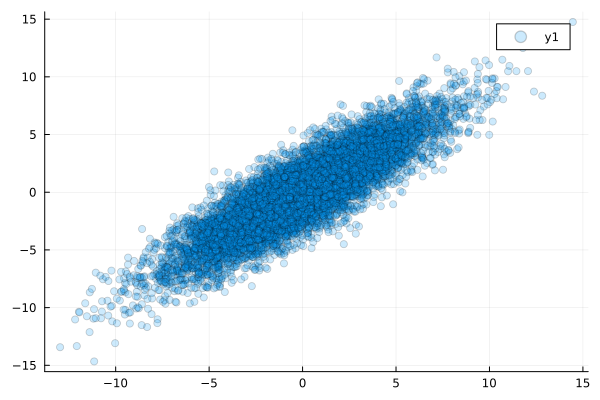

In [111]:
A = [2 1; 1 2]
transformed_total_samples = linear_transformation(all_samples, A)
plot(transformed_total_samples[1,:], transformed_total_samples[2,:], seriestype=:scatter, alpha=0.2)

In [272]:
transformed_cov1 = A * datacov1 * A'
transformed_cov2 = A * datacov2 * A'

transformed_Ctotinv = inv(cholesky((transformed_cov1 + transformed_cov2)));
transformed_recovered_data1 = transformed_cov1 * transformed_Ctotinv * transformed_total_samples
transformed_recovered_data2 = transformed_cov2 * transformed_Ctotinv * transformed_total_samples

recovered_data1 = inverse_linear_transformation(transformed_recovered_data1, A)
recovered_data2 = inverse_linear_transformation(transformed_recovered_data2, A)

all_recovered_data = recovered_data1 + recovered_data2

# plot(recovered_data1[1,:], recovered_data1[2,:], seriestype=:scatter, alpha=0.2)

2×10000 Matrix{Float64}:
 -0.49653  -1.20526   1.07616  -0.0504392  …   2.88145   -1.21443  -2.63902
  1.61868   2.06483  -1.06135   1.01756       -0.143688  -0.39677  -0.132273

In [273]:
# plot(recovered_data2[1,:], recovered_data2[2,:], seriestype=:scatter, alpha=0.2)

In [118]:
sum(abs.(all_recovered_data.- all_samples))

1.458559922146163e-11

Now, what if we make the transformation slightly nonlinear?

In [141]:
function slightly_nonlinear_function(x1, x2, A; epsilon = -1.5)
   return A * x1 + (1 - epsilon) .* (A * x2)
end

slightly_nonlinear_function (generic function with 1 method)

In [142]:
new_transformed_all_samples = slightly_nonlinear_function(samples1, samples2, A)

2×10000 Matrix{Float64}:
 0.610903  3.14778  1.5687    2.8084   …  10.9158   -1.55869  -13.9991
 4.55563   6.18817  0.388743  4.99695      5.64589  -1.59428  -10.7742

In [274]:
# plot_2d_dist(new_all_samples)

In [144]:
transformed_recovered_data1 = transformed_cov1 * transformed_Ctotinv * new_transformed_all_samples
transformed_recovered_data2 = transformed_cov2 * transformed_Ctotinv * new_transformed_all_samples

2×10000 Matrix{Float64}:
 0.59969  2.01579  0.837075  1.76589  …  6.00757  -0.906806  -7.92406
 2.08061  3.1283   0.375193  2.56084     3.9025   -0.903401  -6.55687

In [145]:
recovered_data1 = inverse_linear_transformation(transformed_recovered_data1, A)
recovered_data2 = inverse_linear_transformation(transformed_recovered_data2, A)

2×10000 Matrix{Float64}:
 -0.293742  0.301091   0.432986   0.323642  …  2.70422   -0.303404  -3.09708
  1.18717   1.4136    -0.0288963  1.1186       0.599142  -0.299999  -1.72989

In [146]:
plot(recovered_data1[1,:], recovered_data1[2,:], seriestype=:scatter, alpha = 0.2, label="component 1")
plot!(recovered_data2[1,:], recovered_data2[2,:], seriestype=:scatter, alpha = 0.2, label="component 2")